In [1]:
import skimage
import os
from skimage import io
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.color import rgb2hsv
import re
import numpy as np
import seaborn as sns
## for the stats class
import scipy.signal as sg
from skimage.transform import rescale, resize, downscale_local_mean
from sklearn.decomposition import SparsePCA
import pywt
from scipy import stats
import timeit 
#import optshrink as opt # package we create
import numpy as np
# import scipy.io as sio
import h5py
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import seaborn as sns
import pandas as pd
from datetime import datetime
import pytz
from sklearn.mixture import GaussianMixture
from matplotlib.colors import LogNorm
from skimage import io
from patchify import patchify, unpatchify
%matplotlib inline



import collections
# from itertools import chain
# import urllib.request as request
# import pickle 

import numpy as np

import scipy.signal as signal
import scipy.special as special
import scipy.optimize as optimize

import matplotlib.pyplot as plt

import skimage.io
import skimage.transform

# import cv2

# from libsvm import svmutil



In [2]:
fog_aware3 = pd.read_csv('fog_aware_stats_horizontal_3_patches.csv')
fog_aware6 = pd.read_csv('fog_aware_stats_horizontal_6_patches.csv')
fog_aware4 = pd.read_csv('fog_aware_stats_4_equal_patches.csv')
fog_aware0 = pd.read_csv('fog_aware_stats_no_patches.csv')
image_files_summary = pd.read_csv('surfline_photo_data_description.csv')
fog_aware3=fog_aware3.drop(['Unnamed: 0'], axis = 1)
fog_aware6=fog_aware6.drop(['Unnamed: 0'], axis = 1)
fog_aware4=fog_aware4.drop(['Unnamed: 0'], axis = 1)
fog_aware0=fog_aware0.drop(['Unnamed: 0', 'mc', 'patch'], axis = 1)
image_files_summary=image_files_summary.drop(['Unnamed: 0', 't', 'tt'], axis = 1)

image_files_summary['site'] = image_files_summary['site'].str.replace(' 11', '')


In [3]:
image_files_summary.site.unique()

array(['agatebeachor', 'lincolncityor', 'pacificcityor', 'beverlyor',
       'otterrockor', 'cannonbeach'], dtype=object)

In [39]:
fog_aware0.dropna()

,photo,mscn_var,vertical_var,sharpness,coef_or_var_sharpness,entropy,dark_channel_prior,color_sat,CF,rms_contrast
0,2023_05-18.0730_agatebeachor.jpg,0.400531,0.174231,0.013945,0.031354,3.418808,12,0.049917,154.172590,0.128341
1,2023_05-03.1930_agatebeachor.jpg,0.428614,0.250186,0.035352,0.080246,3.618904,0,0.090537,130.088153,0.236619
2,2023_05-18.1630_agatebeachor.jpg,0.497096,0.283645,0.031481,0.070764,3.733268,0,0.044385,124.932711,0.203196
3,2023_05-18.2030_agatebeachor.jpg,0.489366,0.245727,0.026081,0.064925,3.877502,0,0.058747,129.048185,0.264853
4,2023_05-30.2100_agatebeachor.jpg,0.544097,0.323963,0.042678,0.127754,4.184138,0,0.072785,154.018131,0.373667
...,...,...,...,...,...,...,...,...,...,...
7996,2022_08-23.1300_otterrockor.jpg,0.621287,0.399644,0.049130,0.125400,3.974672,0,0.339385,118.213528,0.350942
7997,2023_07-27.1500_pacificcityor.jpg,0.466839,0.349479,0.036533,0.098282,3.817321,0,0.398659,163.920445,0.312644
7998,2022_09-09.1230_otterrockor.jpg,0.594765,0.377161,0.047131,0.115695,3.897867,0,0.170958,160.206664,0.284107
7999,2023_05-25.1200_cannonbeach.jpg,0.411694,0.217776,0.022707,0.048066,3.865190,4,0.181872,152.473556,0.229187


In [43]:
###how do the patches compare to different sites?
fog_aware3=fog_aware3.merge(image_files_summary[['photo', 'Label', 'site', 'hour' ]]
                          , on = 'photo')
fog_aware6=fog_aware6.merge(image_files_summary[['photo', 'Label', 'site', 'hour' ]]
                          , on = 'photo')
fog_aware4=fog_aware4.merge(image_files_summary[['photo', 'Label', 'site', 'hour' ]]
                          , on = 'photo')
fog_aware0=fog_aware0.merge(image_files_summary[['photo', 'Label', 'site', 'hour' ]]
                          , on = 'photo')


In [44]:
fog_aware3['patch'] = fog_aware3['patch'].astype(str)
fog_aware3_pivot = fog_aware3.pivot(
index = ['photo', 'Label', 'site', 'hour']
    ,columns = ['patch']
    , values = [ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'rms_contrast', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF']
)
fog_aware3_pivot.columns = fog_aware3_pivot.columns.map('_'.join)
fog_aware3_pivot=fog_aware3_pivot.reset_index()
print(fog_aware3_pivot.columns)

fog_aware3_pivot.dropna().to_csv('fog_aware_stats_horizontal_3_patches_pivot.csv', index=False)


fog_aware6['patch'] = fog_aware6['patch'].astype(str)
fog_aware6_pivot = fog_aware6.pivot(
index = ['photo', 'Label', 'site', 'hour']
    ,columns = ['patch']
    , values = [ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'rms_contrast', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF']
)
# fog_aware6_pivot.reset_index()
# fog_aware6_pivot.index = fog_aware6_pivot.index.astype(str)
fog_aware6_pivot.columns = fog_aware6_pivot.columns.map('_'.join)
fog_aware6_pivot=fog_aware6_pivot.reset_index()
print(fog_aware6_pivot.columns)

fog_aware6_pivot.dropna().to_csv('fog_aware_stats_horizontal_6_patches_pivot.csv', index=False)

fog_aware4['patch'] = fog_aware4['patch'].astype(str)
fog_aware4_pivot = fog_aware4.pivot(
index = ['photo', 'Label', 'site', 'hour']
    ,columns = ['patch']
    , values = [ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'rms_contrast', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF']
)
fog_aware4_pivot.columns = fog_aware4_pivot.columns.map('_'.join)
fog_aware4_pivot=fog_aware4_pivot.reset_index()
print(fog_aware4_pivot.columns)

fog_aware4_pivot.dropna().to_csv('fog_aware_stats_4_equal_patches_pivot.csv', index=False)

fog_aware0.dropna().to_csv('fog_aware_stats_no_patches_pivot.csv', index=False)


Index(['photo', 'Label', 'site', 'hour', 'mscn_var_0', 'mscn_var_1',
       'mscn_var_2', 'vertical_var_0', 'vertical_var_1', 'vertical_var_2',
       'sharpness_0', 'sharpness_1', 'sharpness_2', 'coef_or_var_sharpness_0',
       'coef_or_var_sharpness_1', 'coef_or_var_sharpness_2', 'rms_contrast_0',
       'rms_contrast_1', 'rms_contrast_2', 'entropy_0', 'entropy_1',
       'entropy_2', 'dark_channel_prior_0', 'dark_channel_prior_1',
       'dark_channel_prior_2', 'color_sat_0', 'color_sat_1', 'color_sat_2',
       'CF_0', 'CF_1', 'CF_2'],
      dtype='object')
Index(['photo', 'Label', 'site', 'hour', 'mscn_var_0', 'mscn_var_1',
       'mscn_var_2', 'mscn_var_3', 'mscn_var_4', 'mscn_var_5',
       'vertical_var_0', 'vertical_var_1', 'vertical_var_2', 'vertical_var_3',
       'vertical_var_4', 'vertical_var_5', 'sharpness_0', 'sharpness_1',
       'sharpness_2', 'sharpness_3', 'sharpness_4', 'sharpness_5',
       'coef_or_var_sharpness_0', 'coef_or_var_sharpness_1',
       'coef_or_var

In [36]:
fog_aware0

,photo,patch,mscn_var,vertical_var,sharpness,coef_or_var_sharpness,entropy,dark_channel_prior,color_sat,CF,rms_contrast
0,2023_05-18.0730_agatebeachor.jpg,NaN,0.400531,0.174231,0.013945,0.031354,3.418808,12,0.049917,154.172590,0.128341
1,2023_05-03.1930_agatebeachor.jpg,NaN,0.428614,0.250186,0.035352,0.080246,3.618904,0,0.090537,130.088153,0.236619
2,2023_05-18.1630_agatebeachor.jpg,NaN,0.497096,0.283645,0.031481,0.070764,3.733268,0,0.044385,124.932711,0.203196
3,2023_05-18.2030_agatebeachor.jpg,NaN,0.489366,0.245727,0.026081,0.064925,3.877502,0,0.058747,129.048185,0.264853
4,2023_05-30.2100_agatebeachor.jpg,NaN,0.544097,0.323963,0.042678,0.127754,4.184138,0,0.072785,154.018131,0.373667
...,...,...,...,...,...,...,...,...,...,...,...
7996,2022_08-23.1300_otterrockor.jpg,NaN,0.621287,0.399644,0.049130,0.125400,3.974672,0,0.339385,118.213528,0.350942
7997,2023_07-27.1500_pacificcityor.jpg,NaN,0.466839,0.349479,0.036533,0.098282,3.817321,0,0.398659,163.920445,0.312644
7998,2022_09-09.1230_otterrockor.jpg,NaN,0.594765,0.377161,0.047131,0.115695,3.897867,0,0.170958,160.206664,0.284107
7999,2023_05-25.1200_cannonbeach.jpg,NaN,0.411694,0.217776,0.022707,0.048066,3.865190,4,0.181872,152.473556,0.229187


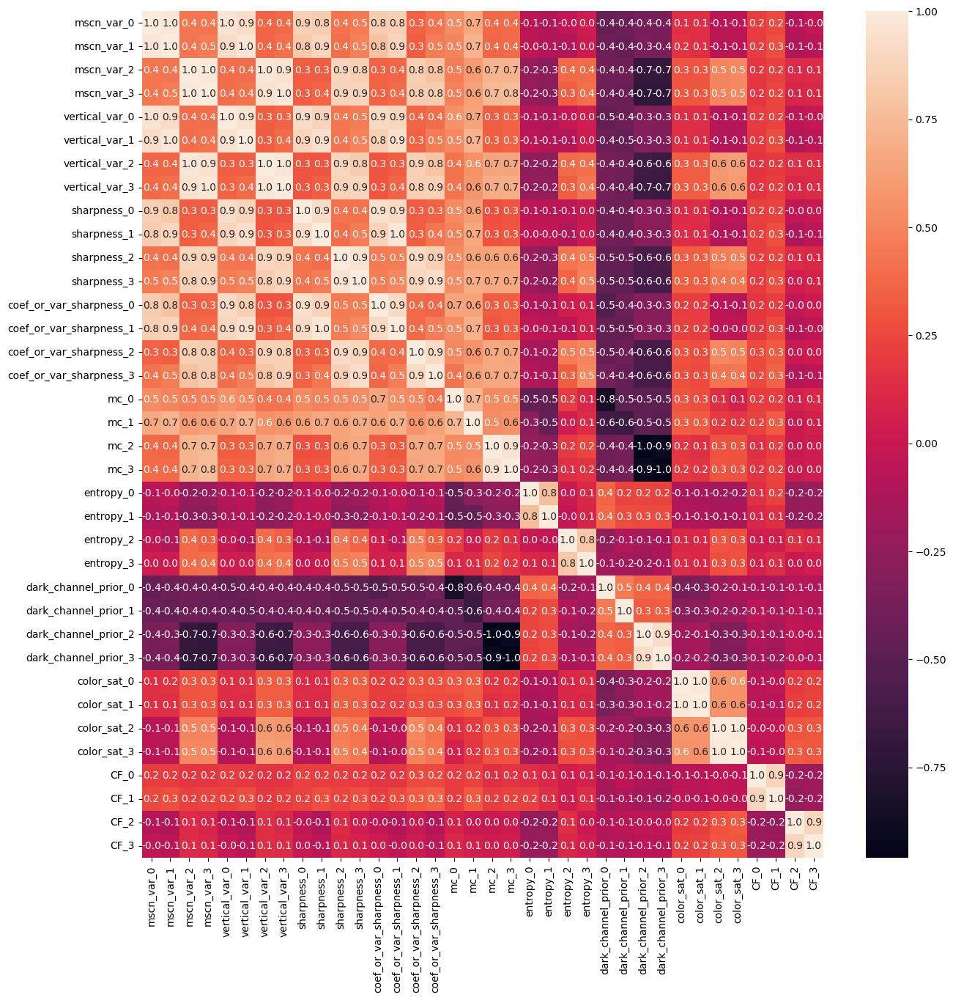

In [43]:
df = fog_aware_pivot[['mscn_var_0', 'mscn_var_1',
       'mscn_var_2', 'mscn_var_3', 'vertical_var_0', 'vertical_var_1',
       'vertical_var_2', 'vertical_var_3', 'sharpness_0', 'sharpness_1',
       'sharpness_2', 'sharpness_3', 'coef_or_var_sharpness_0',
       'coef_or_var_sharpness_1', 'coef_or_var_sharpness_2',
       'coef_or_var_sharpness_3', 'mc_0', 'mc_1', 'mc_2', 'mc_3', 'entropy_0',
       'entropy_1', 'entropy_2', 'entropy_3', 'dark_channel_prior_0',
       'dark_channel_prior_1', 'dark_channel_prior_2', 'dark_channel_prior_3',
       'color_sat_0', 'color_sat_1', 'color_sat_2', 'color_sat_3', 'CF_0',
       'CF_1', 'CF_2', 'CF_3']]

plt.figure(figsize=(15, 15))
df = df.dropna()
matrix = df.corr().round(2)
sns.heatmap(matrix, annot=True, fmt=".1f")
plt.show()

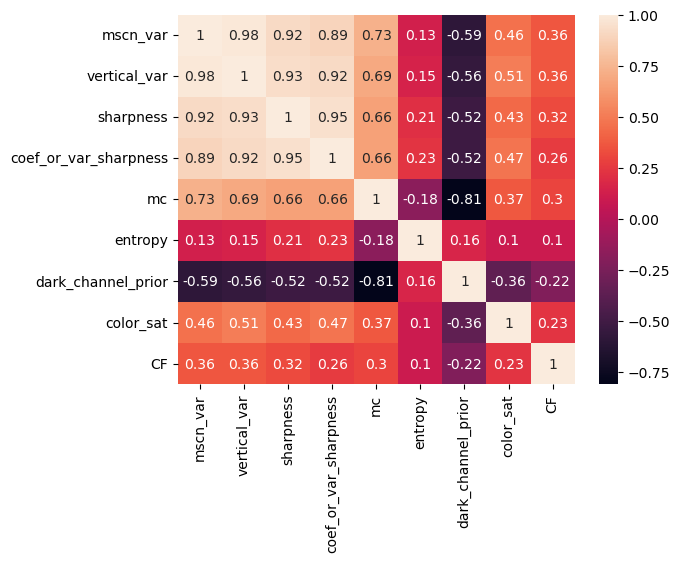

In [18]:
df = fog_aware[[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF']]

df = df.dropna()
matrix = df.corr().round(2)
sns.heatmap(matrix, annot=True)
plt.show()

In [25]:
###random forest (how many times a given variable was chosen to be split)
###logit (cross validate the % to switch to foggy and not foggy)
fog_aware0

,photo,patch,mscn_var,vertical_var,sharpness,coef_or_var_sharpness,mc,entropy,dark_channel_prior,color_sat,CF,rms_contrast,Label,site,hour
0,2023_05-18.0730_agatebeachor.jpg,nan,0.400531,0.174231,0.013945,0.031354,NaN,3.418808,12,0.049917,154.172590,0.128341,not_foggy,agatebeachor,7
1,2023_05-03.1930_agatebeachor.jpg,nan,0.428614,0.250186,0.035352,0.080246,NaN,3.618904,0,0.090537,130.088153,0.236619,not_foggy,agatebeachor,19
2,2023_05-18.1630_agatebeachor.jpg,nan,0.497096,0.283645,0.031481,0.070764,NaN,3.733268,0,0.044385,124.932711,0.203196,not_foggy,agatebeachor,16
3,2023_05-18.2030_agatebeachor.jpg,nan,0.489366,0.245727,0.026081,0.064925,NaN,3.877502,0,0.058747,129.048185,0.264853,not_foggy,agatebeachor,20
4,2023_05-30.2100_agatebeachor.jpg,nan,0.544097,0.323963,0.042678,0.127754,NaN,4.184138,0,0.072785,154.018131,0.373667,not_foggy,agatebeachor,21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7996,2022_08-23.1300_otterrockor.jpg,nan,0.621287,0.399644,0.049130,0.125400,NaN,3.974672,0,0.339385,118.213528,0.350942,not_foggy,otterrockor,13
7997,2023_07-27.1500_pacificcityor.jpg,nan,0.466839,0.349479,0.036533,0.098282,NaN,3.817321,0,0.398659,163.920445,0.312644,not_foggy,pacificcityor,15
7998,2022_09-09.1230_otterrockor.jpg,nan,0.594765,0.377161,0.047131,0.115695,NaN,3.897867,0,0.170958,160.206664,0.284107,not_foggy,otterrockor,12
7999,2023_05-25.1200_cannonbeach.jpg,nan,0.411694,0.217776,0.022707,0.048066,NaN,3.865190,4,0.181872,152.473556,0.229187,not_foggy,cannonbeach,12


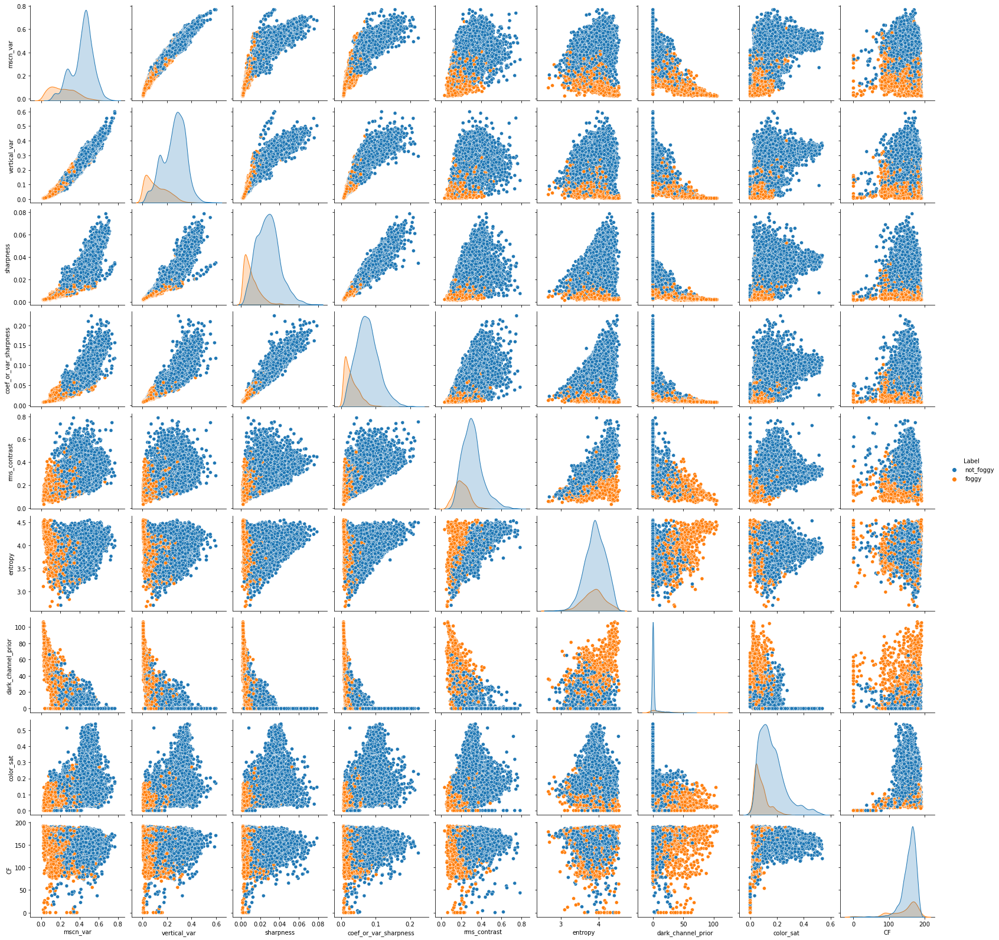

In [28]:
sns.pairplot(fog_aware0[[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'rms_contrast', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'Label']], hue = 'Label')

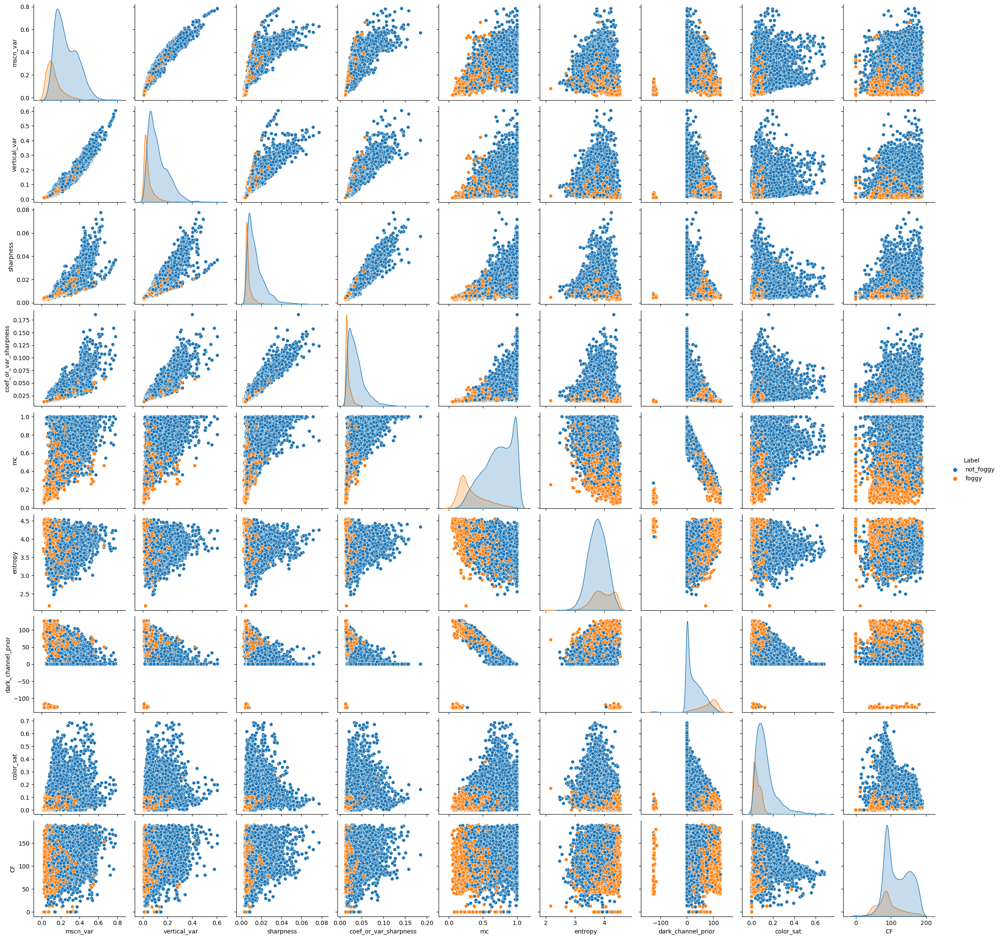

In [6]:
sns.pairplot(fog_aware.loc[fog_aware['patch']==0,[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'Label']], hue = 'Label')

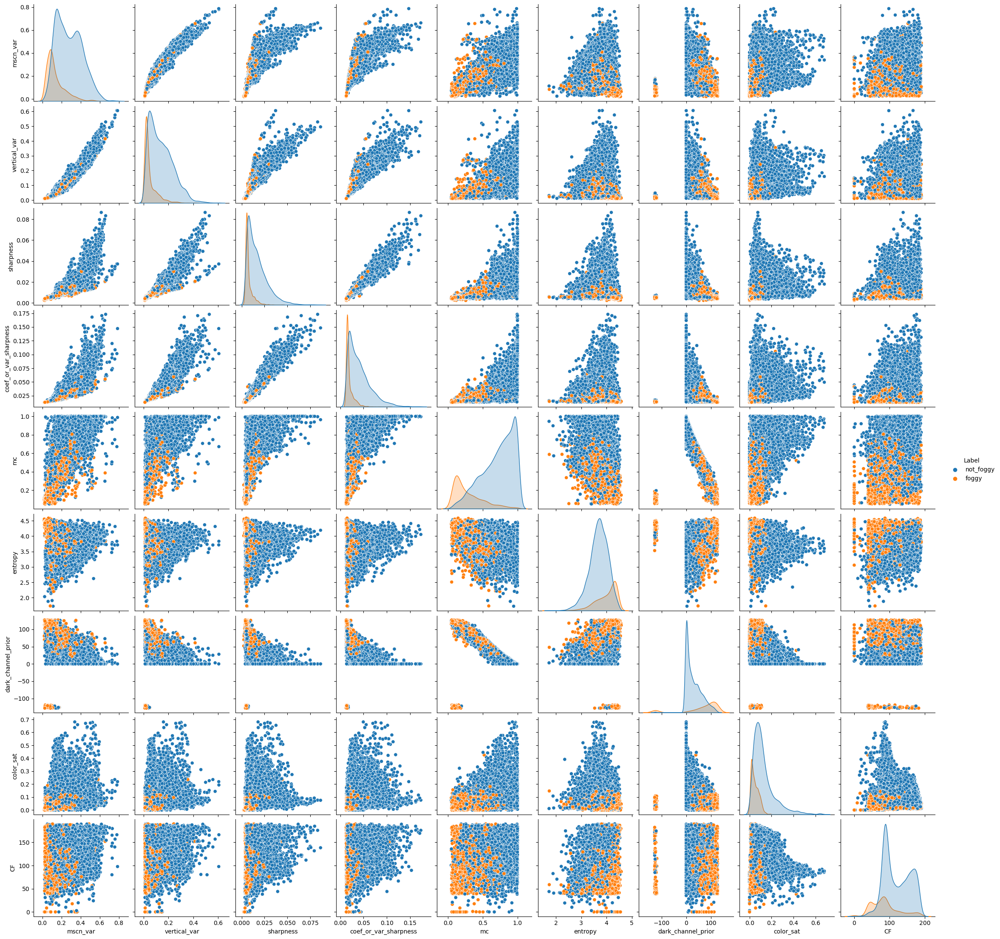

In [7]:
sns.pairplot(fog_aware.loc[fog_aware['patch']==1,[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'Label']], hue = 'Label')

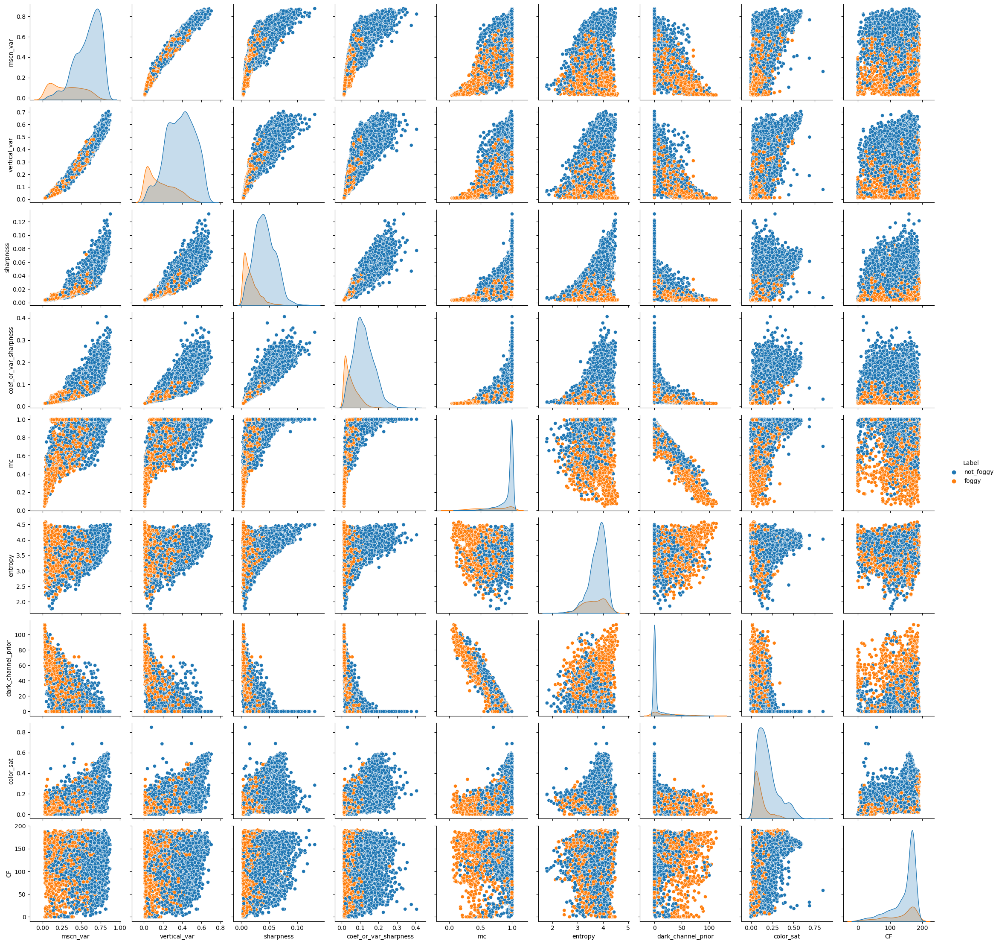

In [8]:
sns.pairplot(fog_aware.loc[fog_aware['patch']==2,[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'Label']], hue = 'Label')

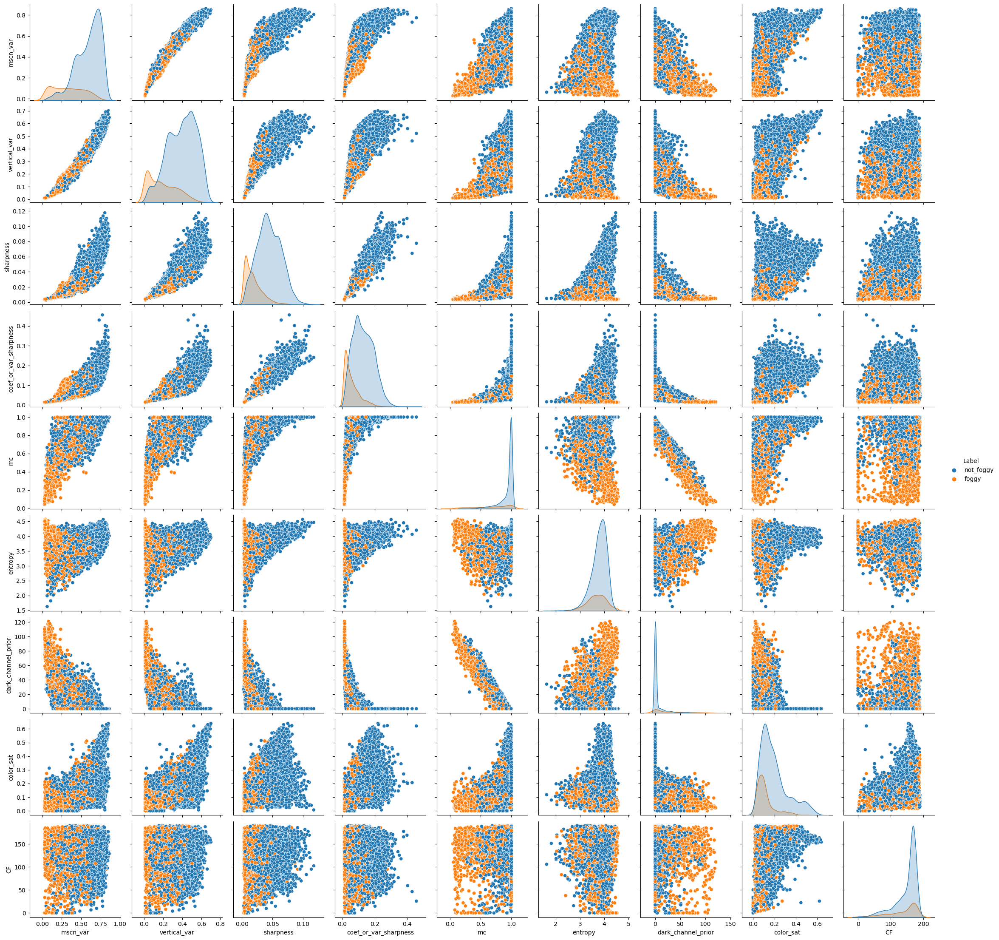

In [9]:
sns.pairplot(fog_aware.loc[fog_aware['patch']==3,[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'Label']], hue = 'Label')

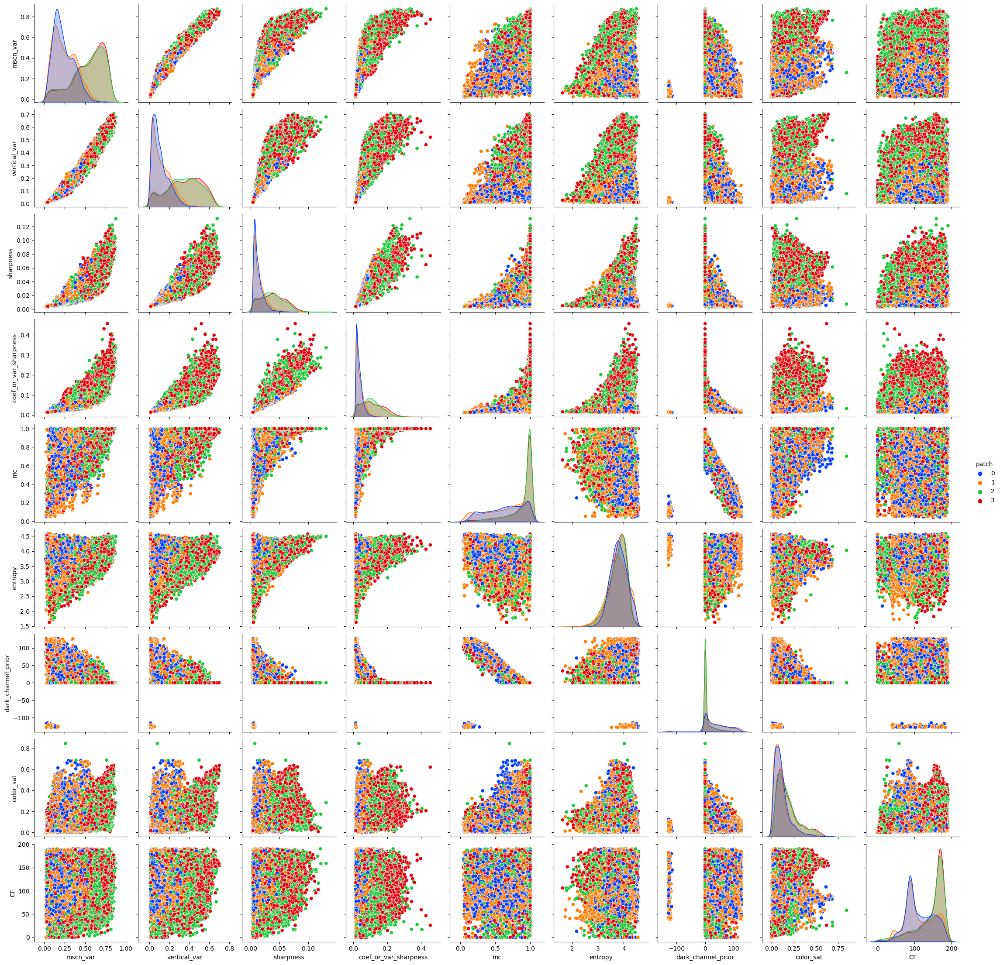

In [10]:
sns.pairplot(fog_aware[[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'patch']], hue = 'patch', palette = 'bright')

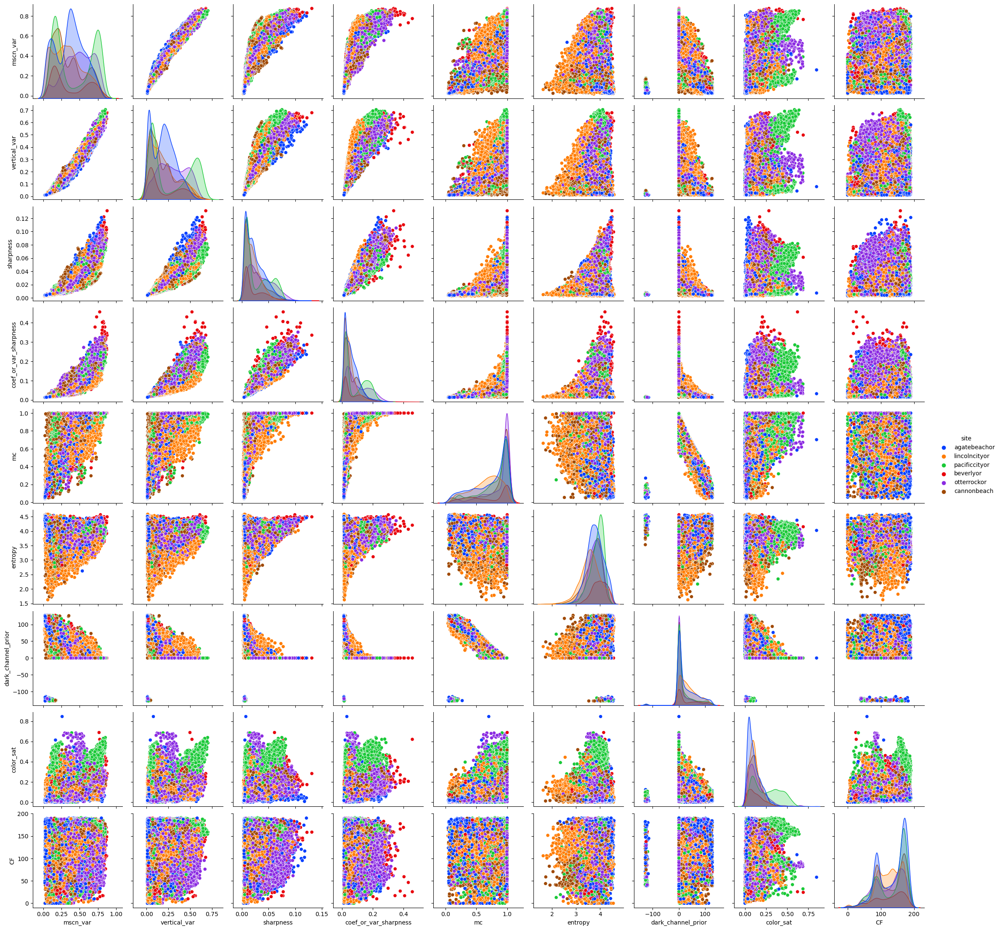

In [11]:
sns.pairplot(fog_aware[[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'site']], hue = 'site', palette = 'bright')

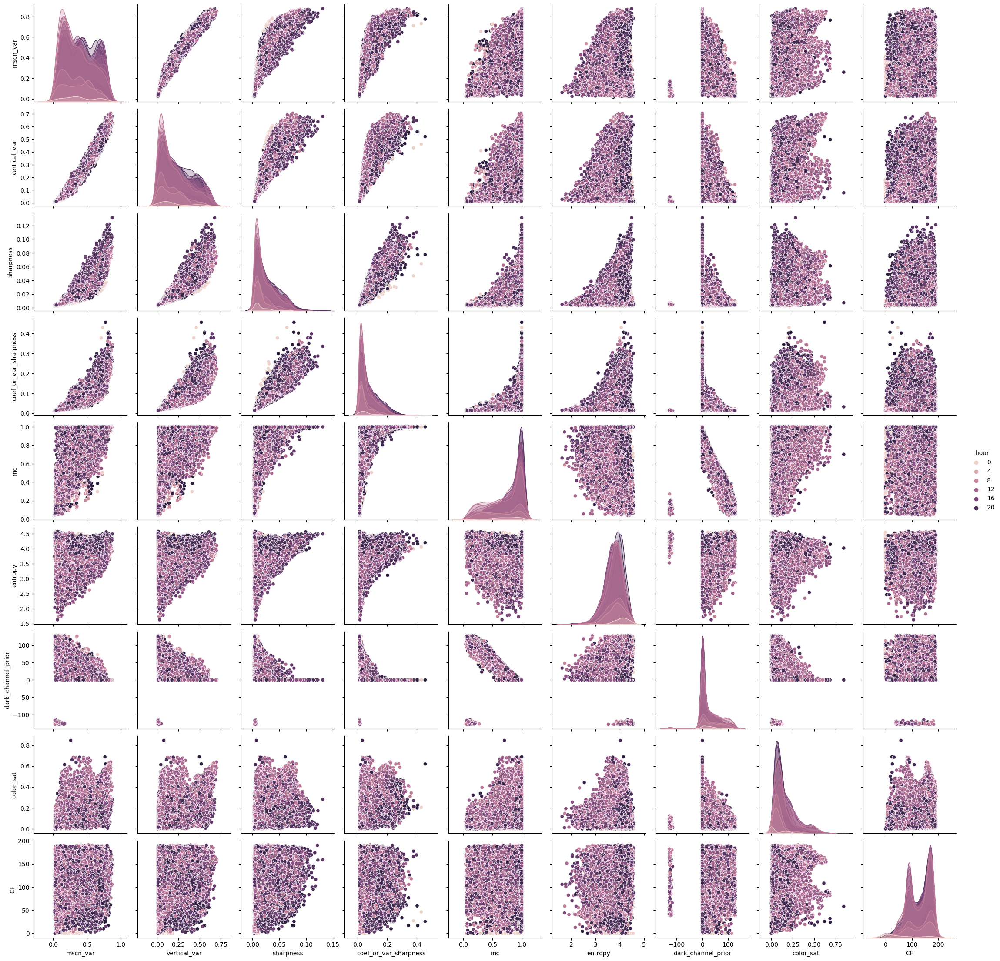

In [88]:
sns.pairplot(fog_aware[[ 'mscn_var', 'vertical_var', 'sharpness',
       'coef_or_var_sharpness', 'mc', 'entropy', 'dark_channel_prior',
       'color_sat', 'CF', 'hour']], hue = 'hour')

In [49]:
fog_aware_pivot = fog_aware_pivot.dropna()

In [52]:
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split

X = np.array(fog_aware_pivot[['mscn_var_0', 'mscn_var_1',
       'mscn_var_2', 'mscn_var_3', 'vertical_var_0', 'vertical_var_1',
       'vertical_var_2', 'vertical_var_3', 'sharpness_0', 'sharpness_1',
       'sharpness_2', 'sharpness_3', 'coef_or_var_sharpness_0',
       'coef_or_var_sharpness_1', 'coef_or_var_sharpness_2',
       'coef_or_var_sharpness_3', 'entropy_0',
       'entropy_1', 'entropy_2', 'entropy_3', 
       'color_sat_0', 'color_sat_1', 'color_sat_2', 'color_sat_3', 'CF_0',
       'CF_1', 'CF_2', 'CF_3']].dropna()
            )


y = np.array(fog_aware_pivot['Label'])
# from sklearn.model_selection import StratifiedKFold
# skf = StratifiedKFold(n_splits=2)
# next(skf.split(X, y))
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.20, random_state=42)

n_classes = len(np.unique(y_train))




[5.78171924e-01 3.67277543e-01 3.28851700e-02 2.15469630e-02
 4.47071369e-05 3.84408510e-05 1.51001134e-05 6.56329073e-06
 4.66674202e-06 3.49139900e-06]


In [76]:
# pca = PCA(n_components=10)

# pca.fit(X)

# print(pca.explained_variance_ratio_)
# pd.DataFrame(pca.explained_variance_ratio_).plot()
# pca = PCA(n_components=2)

# pcs_2 = pd.DataFrame(pca.fit_transform(X))
# pcs_2.columns = ['pc1', 'pc2']

# pcs_2 = pd.concat([pcs_2, fog_aware_pivot['Label']], axis = 1)
# pcs_2
# sns.pairplot(pcs_2, hue = 'Label', palette = 'bright')